<a href="https://colab.research.google.com/github/Immaniyelu2001/Reidentification_in_singlefeed/blob/main/Reidentification_in_singlefeed.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [9]:
!pip install -q ultralytics deep_sort_realtime supervision opencv-python

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.4/8.4 MB 54.2 MB/s eta 0:00:00


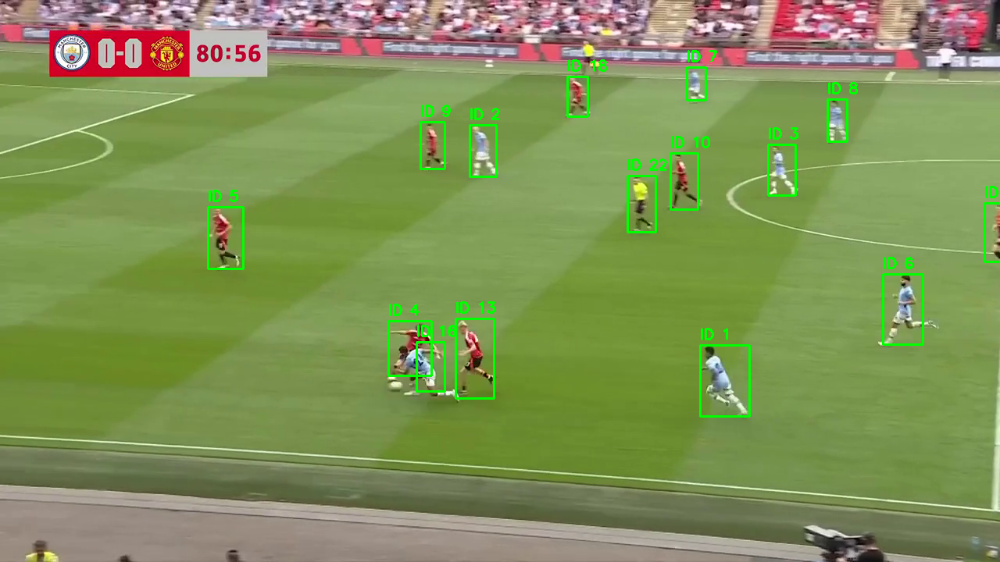

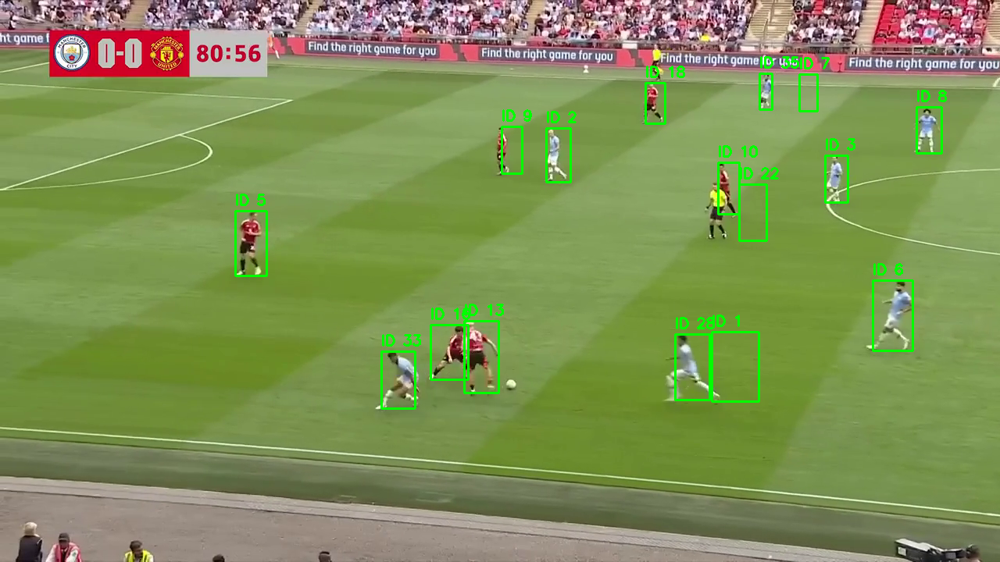

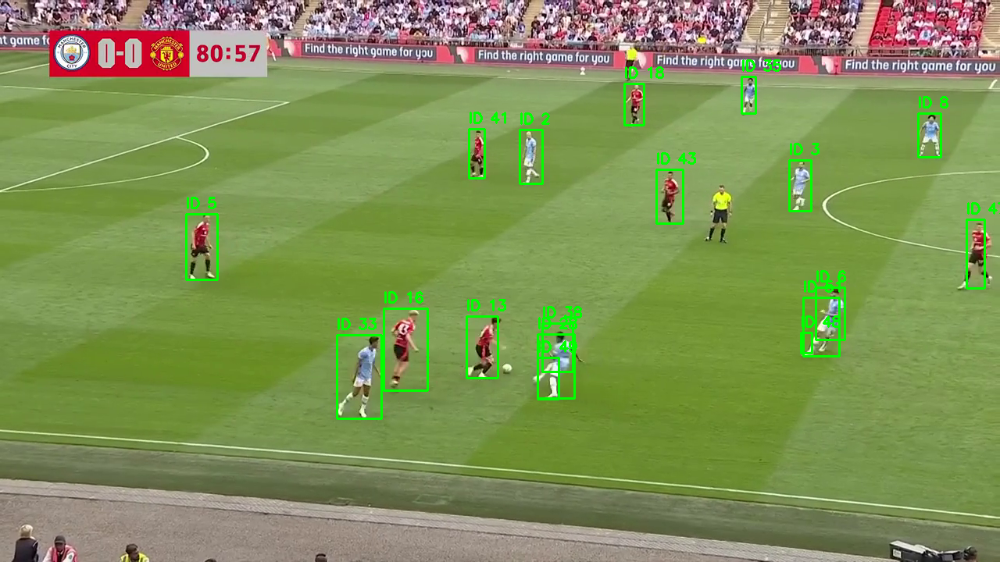

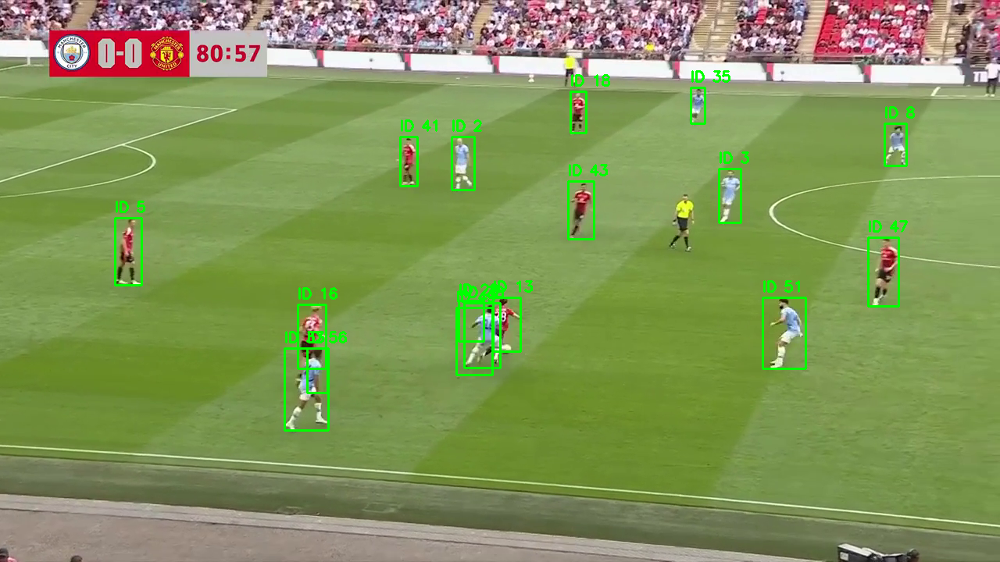

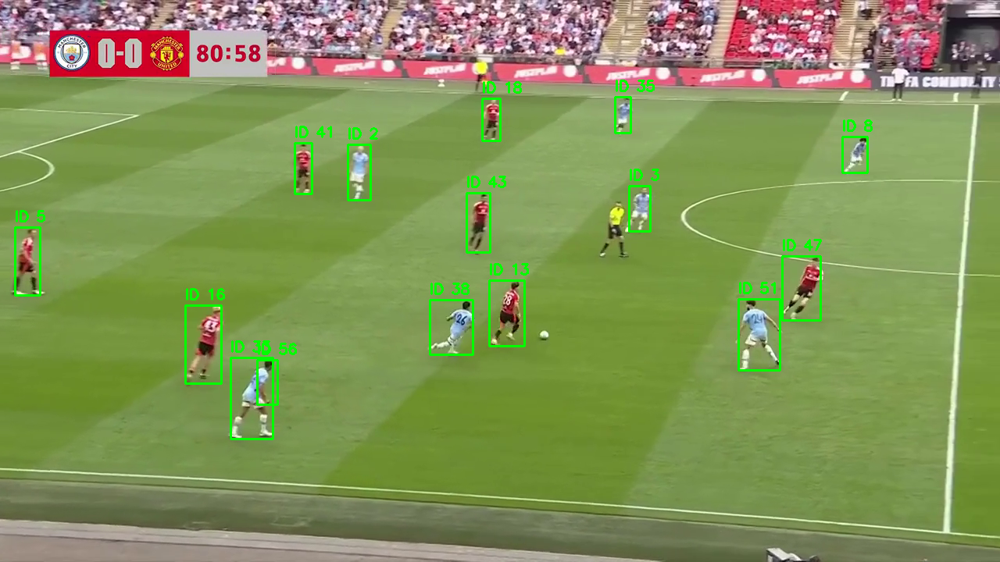

...

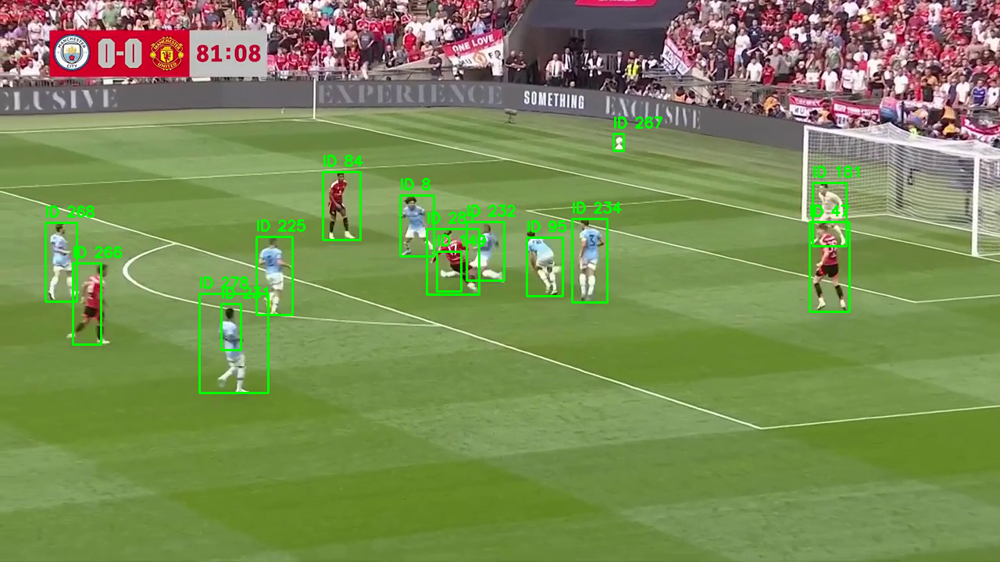

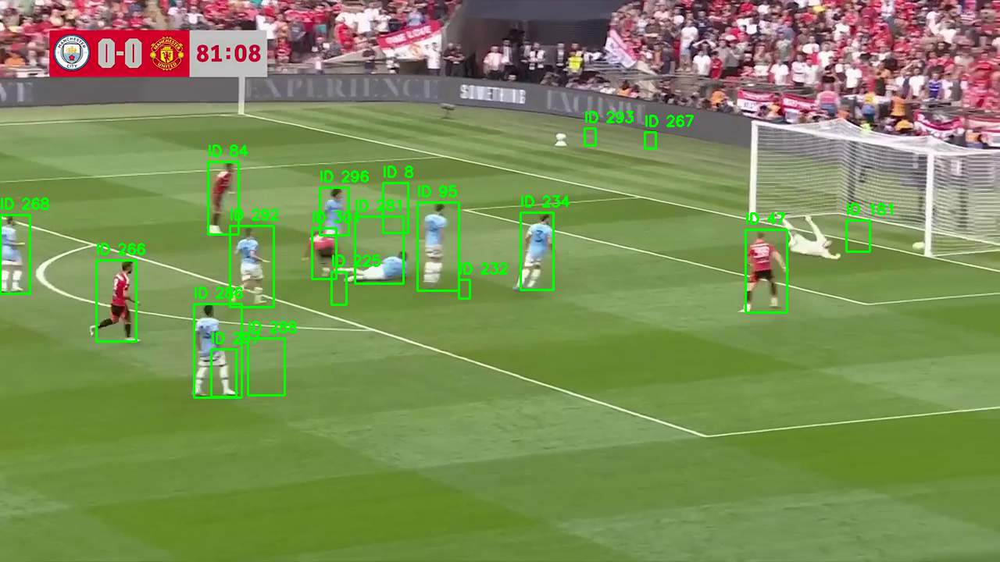

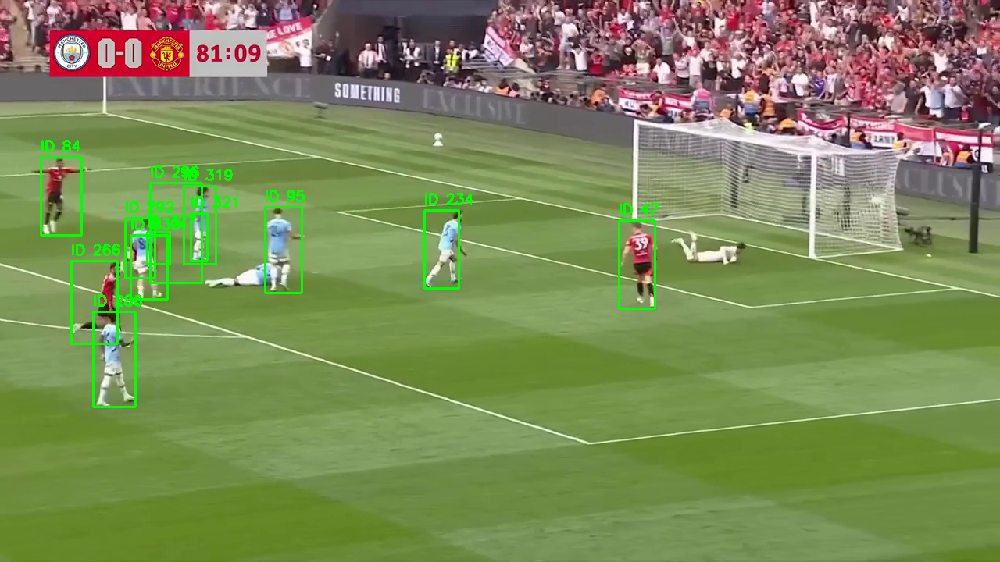

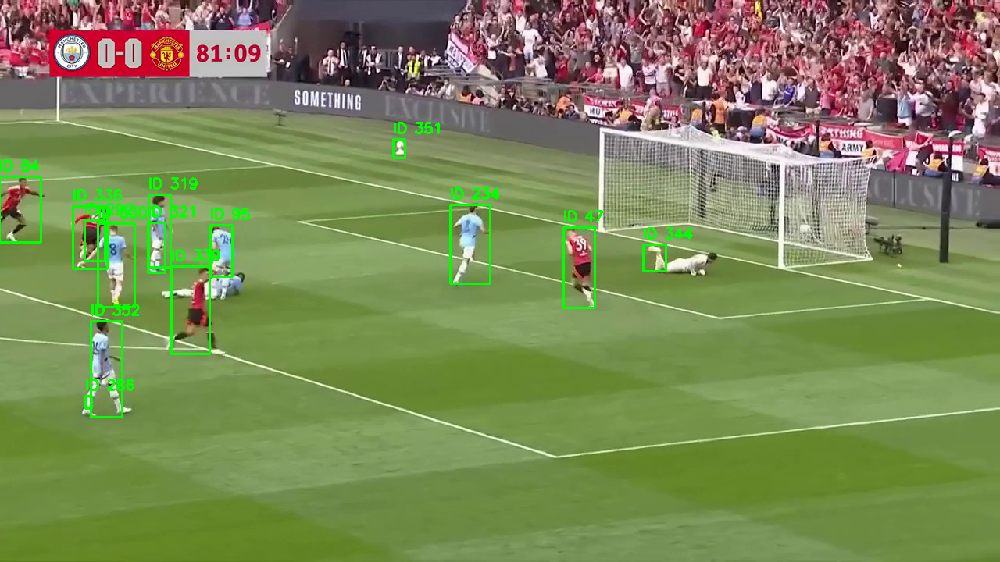

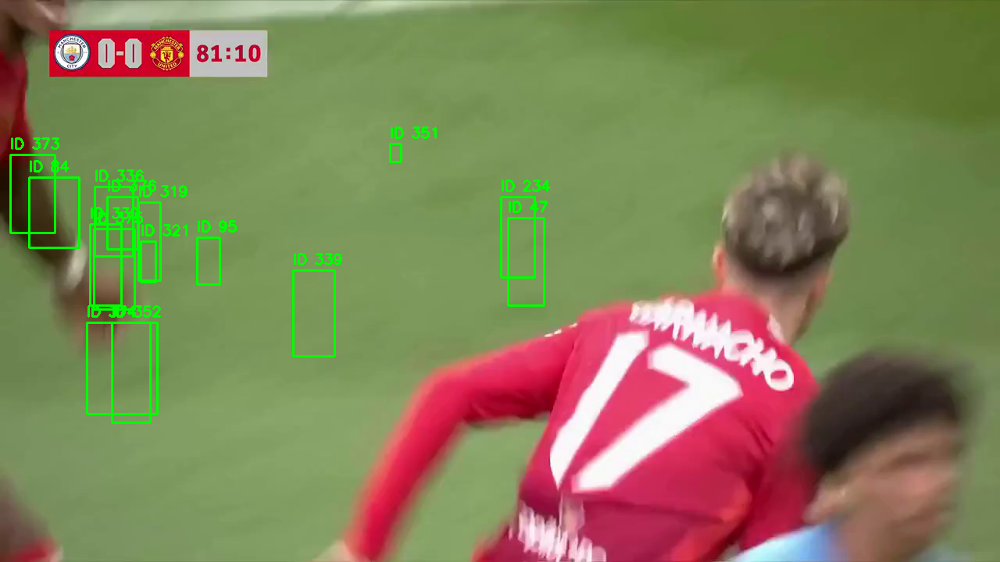

In [12]:
import cv2
from ultralytics import YOLO
from deep_sort_realtime.deepsort_tracker import DeepSort
from google.colab.patches import cv2_imshow
from google.colab import files

# Load custom YOLOv11 model (trained to detect "player" and "ball")
yolo_model = YOLO("/content/best.pt")

# Initialize Deep SORT with tuned parameters
tracker = DeepSort(
    max_age=10,             # forget ID after 10 missed frames
    n_init=3,               # require 3 hits to confirm a track
    max_iou_distance=0.7,   # stricter match
    nn_budget=30            # how many appearance features to remember
)

# Load input video
cap = cv2.VideoCapture("/content/15sec_input_720p.mp4")
fps = int(cap.get(cv2.CAP_PROP_FPS))
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Output video writer
output = cv2.VideoWriter("output_reid.mp4", cv2.VideoWriter_fourcc(*"mp4v"), fps, (width, height))

frame_count = 0

while True:
    ret, frame = cap.read()
    if not ret:
        break
    frame_count += 1

    # Run YOLO detection
    result = yolo_model.predict(source=frame, conf=0.4, verbose=False)[0]

    detections = []
    for box in result.boxes:
        cls = int(box.cls[0])
        class_name = yolo_model.names[cls]

        if class_name == "player":
            # Use YOLO's xywh format (center x/y, width, height)
            x_center, y_center, w, h = box.xywh[0].tolist()
            bbox = [int(x_center - w / 2), int(y_center - h / 2), int(w), int(h)]
            conf = float(box.conf[0])
            detections.append((bbox, conf, class_name))

    # Update tracker with detections
    tracks = tracker.update_tracks(detections, frame=frame)

    for track in tracks:
        if not track.is_confirmed():
            continue

        track_id = track.track_id
        l, t, r, b = map(int, track.to_ltrb())

        # Draw box and ID label
        cv2.rectangle(frame, (l, t), (r, b), (0, 255, 0), 2)
        cv2.putText(frame, f'ID {track_id}', (l, t - 8),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0, 255, 0), 2)

    # Write frame to output video
    output.write(frame)

    # Show every 15th frame in Colab
    if frame_count % 15 == 0:
        cv2_imshow(frame)

cap.release()
output.release()